In [25]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from tensorflow.keras.preprocessing.image import load_img, img_to_array
import os

In [26]:
img_dir = r'/Users/miloszksiazek/Desktop/ALK/python_ML/FINAL/dogs_cats/train'
images = os.listdir(img_dir)
images[:5]

['dog.8011.jpg',
 'cat.5077.jpg',
 'dog.7322.jpg',
 'cat.2718.jpg',
 'cat.10151.jpg']

In [27]:
full_images = [os.path.join(img_dir, img) for img in images]
full_images[:3]

['/Users/miloszksiazek/Desktop/ALK/python_ML/FINAL/dogs_cats/train/dog.8011.jpg',
 '/Users/miloszksiazek/Desktop/ALK/python_ML/FINAL/dogs_cats/train/cat.5077.jpg',
 '/Users/miloszksiazek/Desktop/ALK/python_ML/FINAL/dogs_cats/train/dog.7322.jpg']

In [28]:
len(full_images)

25000

Text(0.5, 1.0, 'dog.1118.jpg')

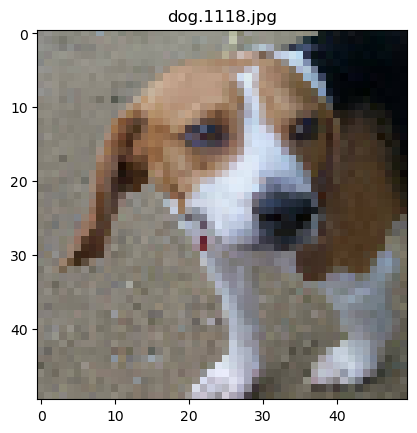

In [29]:
image_index = 10000
img = load_img(full_images[image_index], target_size=(50, 50))
plt.imshow(img)
plt.title(images[image_index])

In [30]:
img_array = img_to_array(load_img(full_images[image_index], target_size=(50, 50)))

In [31]:
img_array.shape

(50, 50, 3)

In [32]:
from scipy.signal import convolve2d

In [33]:
from imports_for_ML import load_images

X, y = load_images(img_dir, n_images=20000, resize=(50, 50))

**************************************************
**************************************************
**************************************************
**************************************************
**************************************************
**************************************************
**************************************************
**************************************************
**************************************************
**************************************************
**************************************************
**************************************************
**************************************************
**************************************************
**************************************************
**************************************************
**************************************************
**************************************************
**************************************************
*******************************

In [13]:
X.shape

(20000, 50, 50, 3)

In [34]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.05, random_state=123)

In [23]:
#

In [35]:
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import Conv2D, MaxPooling2D, Flatten
!pip install tensorflow-addons
import tensorflow_addons as tfa


In [41]:
model1 = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(50, 50, 3)),
    MaxPooling2D(3, 3),
    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D(2,2),
    Conv2D(128, (3, 3), activation='relu'),
    MaxPooling2D(2,2),
    Flatten(),
    Dense(512, activation='relu'),
    Dense(1, activation='sigmoid')
])
model1.compile(loss="binary_crossentropy", optimizer=tfa.optimizers.AdamW(weight_decay=1e-4), metrics=['accuracy'])


In [19]:
X.shape

(20000, 50, 50, 3)

In [36]:
from keras.callbacks import EarlyStopping

stop_early = EarlyStopping(patience=4)

In [44]:
history = model1.fit(X_train, y_train, epochs=10, validation_split=0.04, callbacks=[stop_early])

Epoch 1/10


2024-01-30 17:50:34.211631: W tensorflow/tsl/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz


570/570 [==============================] - 8s 14ms/step - loss: 0.9573 - accuracy: 0.6052 - val_loss: 0.6339 - val_accuracy: 0.6539
Epoch 2/10
570/570 [==============================] - 8s 14ms/step - loss: 0.6018 - accuracy: 0.6770 - val_loss: 0.5987 - val_accuracy: 0.6750
Epoch 3/10
570/570 [==============================] - 8s 14ms/step - loss: 0.5598 - accuracy: 0.7092 - val_loss: 0.5384 - val_accuracy: 0.7421
Epoch 4/10
570/570 [==============================] - 9s 15ms/step - loss: 0.5272 - accuracy: 0.7385 - val_loss: 0.5329 - val_accuracy: 0.7171
Epoch 5/10
570/570 [==============================] - 8s 15ms/step - loss: 0.5052 - accuracy: 0.7525 - val_loss: 0.5190 - val_accuracy: 0.7316
Epoch 6/10
570/570 [==============================] - 9s 16ms/step - loss: 0.4716 - accuracy: 0.7759 - val_loss: 0.4445 - val_accuracy: 0.8026
Epoch 7/10
570/570 [==============================] - 9s 16ms/step - loss: 0.4501 - accuracy: 0.7861 - val_loss: 0.4451 - val_accuracy: 0.7882
Epoch 8/10

In [48]:
model1.summary()

Model: "sequential_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_36 (Conv2D)          (None, 48, 48, 32)        896       
                                                                 
 max_pooling2d_36 (MaxPoolin  (None, 16, 16, 32)       0         
 g2D)                                                            
                                                                 
 conv2d_37 (Conv2D)          (None, 14, 14, 64)        18496     
                                                                 
 max_pooling2d_37 (MaxPoolin  (None, 7, 7, 64)         0         
 g2D)                                                            
                                                                 
 conv2d_38 (Conv2D)          (None, 5, 5, 128)         73856     
                                                                 
 max_pooling2d_38 (MaxPoolin  (None, 2, 2, 128)      

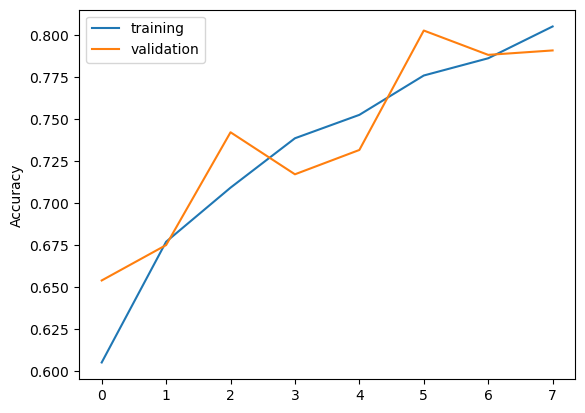

In [45]:
plt.plot(history.history['accuracy'], label='training')
plt.plot(history.history['val_accuracy'], label='validation')
plt.ylabel('Accuracy')
plt.legend()

In [46]:
train_corr = model1.fit(X_train, y_train)
test_corr = model1.fit(X_test, y_test)

32/32 [==============================] - 1s 18ms/step - loss: 0.4978 - accuracy: 0.7720


In [49]:
history_test = model1.fit(X_test, y_test, epochs=10, validation_split=0.04, callbacks=[stop_early])

Epoch 1/10
30/30 [==============================] - 1s 19ms/step - loss: 0.3983 - accuracy: 0.8156 - val_loss: 0.2672 - val_accuracy: 0.9250
Epoch 2/10
30/30 [==============================] - 1s 18ms/step - loss: 0.2858 - accuracy: 0.8771 - val_loss: 0.1971 - val_accuracy: 0.9250
Epoch 3/10
30/30 [==============================] - 1s 18ms/step - loss: 0.2301 - accuracy: 0.9042 - val_loss: 0.1490 - val_accuracy: 0.9750
Epoch 4/10
30/30 [==============================] - 1s 18ms/step - loss: 0.1978 - accuracy: 0.9177 - val_loss: 0.3423 - val_accuracy: 0.8750
Epoch 5/10
30/30 [==============================] - 1s 19ms/step - loss: 0.2076 - accuracy: 0.9167 - val_loss: 0.1549 - val_accuracy: 0.9500


In [37]:
test_sample = X_test[:25]
predictions = model10.predict(test_sample)
true_labels = y_test[:25]

1/1 [==============================] - 0s 20ms/step


/var/folders/wd/5wdb0pjj4cd8s_w239h9zjk40000gn/T/ipykernel_36017/872817793.py:11: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  plt.title(text.format(net_claims * 100., it_is_really, ['is wrong', 'is right'][is_net_correct]))


(-0.5, 49.5, 49.5, -0.5)

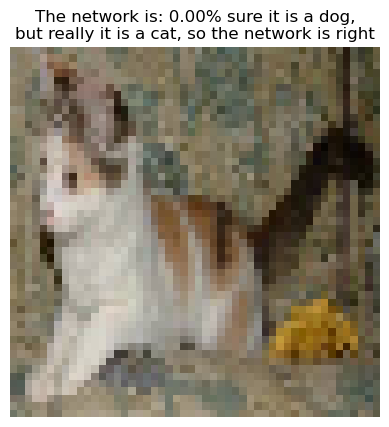

In [39]:
check_idx = 23
plt.imshow(test_sample[check_idx] / 255)


text = 'The network is: {:.2f}% sure it is a dog,\nbut really it is a {}, so the network {}'
correct_response = true_labels[check_idx]
it_is_really = ['cat', 'dog'][correct_response]
net_claims = predictions[check_idx, 0]
is_net_correct = np.abs(net_claims - correct_response) < 0.5

plt.title(text.format(net_claims * 100., it_is_really, ['is wrong', 'is right'][is_net_correct]))
plt.axis('off')

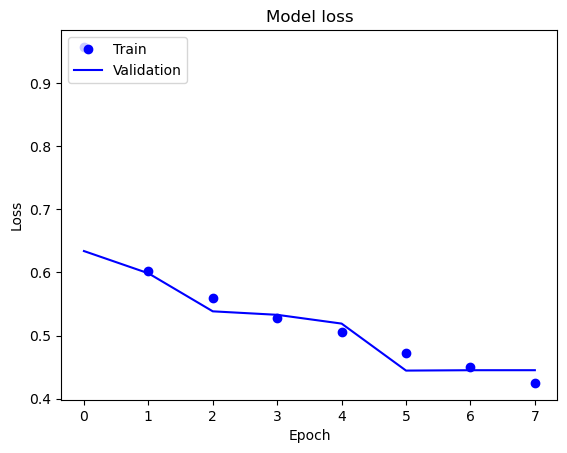

In [86]:
plt.plot(history.history['loss'], 'bo', label='Training loss')  # 'bo' for blue dots
plt.plot(history.history['val_loss'], 'b', label='Validation loss')  # 'b' for blue line
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
#plt.ylim(0, 0.8)  
plt.show()

In [40]:
from keras.layers import Dropout, BatchNormalization

In [64]:
model2 = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(50, 50, 3)),
    BatchNormalization(),
    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D(3,3),
    Conv2D(128, (3, 3), activation='relu'),
    BatchNormalization(),
    MaxPooling2D(2, 2),
    Flatten(),
    Dense(512, activation='relu'),
    Dropout(0.5),
    Dense(1, activation='sigmoid')
])
model2.compile(loss="binary_crossentropy", optimizer=tfa.optimizers.AdamW(weight_decay=1e-4), metrics=['accuracy'])


In [65]:
history2 = model2.fit(X_train, y_train, epochs=20, validation_split=0.04, callbacks=[stop_early])

Epoch 1/20
570/570 [==============================] - 34s 60ms/step - loss: 0.7122 - accuracy: 0.6579 - val_loss: 0.6157 - val_accuracy: 0.7184
Epoch 2/20
570/570 [==============================] - 33s 58ms/step - loss: 0.4913 - accuracy: 0.7620 - val_loss: 0.4662 - val_accuracy: 0.7737
Epoch 3/20
570/570 [==============================] - 33s 58ms/step - loss: 0.4246 - accuracy: 0.8013 - val_loss: 0.5723 - val_accuracy: 0.7303
Epoch 4/20
570/570 [==============================] - 34s 59ms/step - loss: 0.3818 - accuracy: 0.8286 - val_loss: 0.6198 - val_accuracy: 0.7395


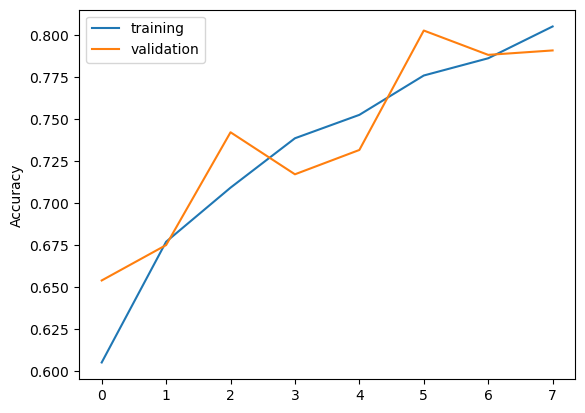

In [66]:
plt.plot(history.history['accuracy'], label='training')
plt.plot(history.history['val_accuracy'], label='validation')
plt.ylabel('Accuracy')
plt.legend()

In [67]:
train_corr = model1.fit(X_train, y_train)
test_corr = model1.fit(X_test, y_test)

32/32 [==============================] - 0s 13ms/step - loss: 0.3759 - accuracy: 0.8350


In [68]:
predictions = model2.predict(test_sample)

1/1 [==============================] - 0s 62ms/step


/var/folders/wd/5wdb0pjj4cd8s_w239h9zjk40000gn/T/ipykernel_33005/4149230061.py:11: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  plt.title(text.format(net_claims * 100., it_is_really, ['is wrong', 'is right'][is_net_correct]))


(-0.5, 49.5, 49.5, -0.5)

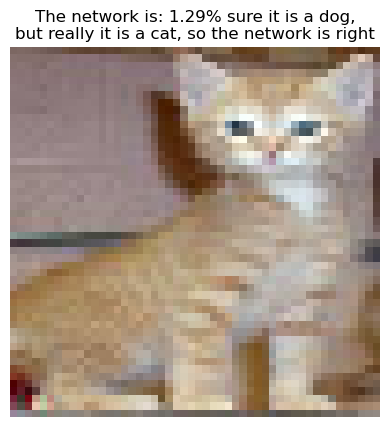

In [74]:
check_idx = 5
plt.imshow(test_sample[check_idx] / 255)


text = 'The network is: {:.2f}% sure it is a dog,\nbut really it is a {}, so the network {}'
correct_response = true_labels[check_idx]
it_is_really = ['cat', 'dog'][correct_response]
net_claims = predictions[check_idx, 0]
is_net_correct = np.abs(net_claims - correct_response) < 0.5

plt.title(text.format(net_claims * 100., it_is_really, ['is wrong', 'is right'][is_net_correct]))
plt.axis('off')

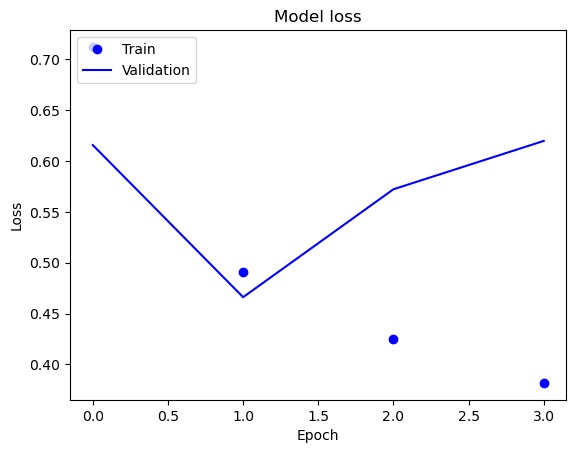

In [87]:
plt.plot(history2.history['loss'], 'bo', label='Training loss')  # 'bo' for blue dots
plt.plot(history2.history['val_loss'], 'b', label='Validation loss')  # 'b' for blue line
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
#plt.ylim(0, 1)  
plt.show()

In [90]:
model3 = Sequential([
    Conv2D(64, (3, 3), activation='relu', input_shape=(50, 50, 3)),
    BatchNormalization(),
    MaxPooling2D(3, 3),
    Conv2D(128, (3, 3), activation='relu'),
    BatchNormalization(),
    Conv2D(256, (3, 3), activation='relu'),
    MaxPooling2D(2, 2),
    Flatten(),
    Dense(512, activation='relu'),
    Dropout(0.5),
    Dense(1, activation='sigmoid')
])

model3.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

In [88]:
stop_early = EarlyStopping(patience=6)

In [91]:
history3 = model3.fit(X_train, y_train, epochs=30, validation_split=0.04, callbacks=[stop_early])

Epoch 1/30
570/570 [==============================] - 37s 64ms/step - loss: 0.7448 - accuracy: 0.6431 - val_loss: 0.5939 - val_accuracy: 0.6776
Epoch 2/30
570/570 [==============================] - 37s 64ms/step - loss: 0.5413 - accuracy: 0.7265 - val_loss: 0.4962 - val_accuracy: 0.7421
Epoch 3/30
570/570 [==============================] - 37s 65ms/step - loss: 0.4728 - accuracy: 0.7805 - val_loss: 0.5900 - val_accuracy: 0.7237
Epoch 4/30
570/570 [==============================] - 38s 66ms/step - loss: 0.4063 - accuracy: 0.8207 - val_loss: 0.5060 - val_accuracy: 0.7434
Epoch 5/30
570/570 [==============================] - 38s 67ms/step - loss: 0.3550 - accuracy: 0.8491 - val_loss: 0.4591 - val_accuracy: 0.7684
Epoch 6/30
570/570 [==============================] - 37s 65ms/step - loss: 0.3048 - accuracy: 0.8715 - val_loss: 0.4504 - val_accuracy: 0.8197
Epoch 7/30
570/570 [==============================] - 37s 64ms/step - loss: 0.2654 - accuracy: 0.8901 - val_loss: 0.3189 - val_accuracy:

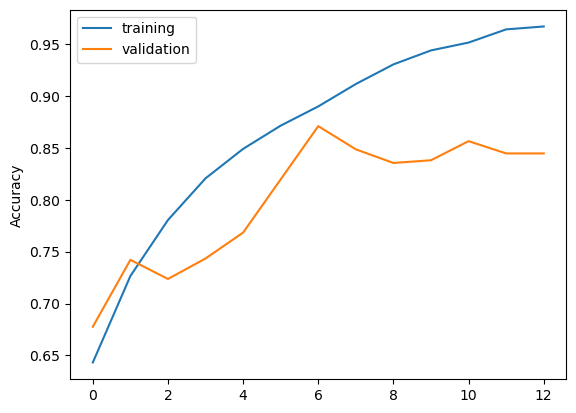

In [92]:
plt.plot(history3.history['accuracy'], label='training')
plt.plot(history3.history['val_accuracy'], label='validation')
plt.ylabel('Accuracy')
plt.legend()

In [93]:
train_corr = model3.fit(X_train, y_train)
test_corr = model3.fit(X_test, y_test)

32/32 [==============================] - 2s 64ms/step - loss: 0.3782 - accuracy: 0.8410


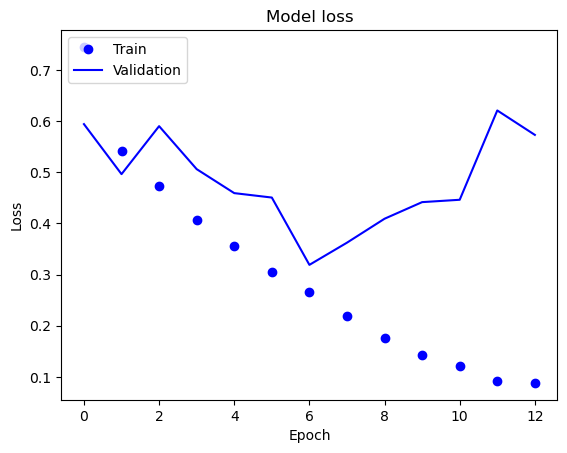

In [94]:
plt.plot(history3.history['loss'], 'bo', label='Training loss')  # 'bo' makes blue dots
plt.plot(history3.history['val_loss'], 'b', label='Validation loss')  # 'b' makes a blue line
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

In [95]:
model4 = Sequential([
    Conv2D(16, (3, 3), activation='relu', input_shape=(50, 50, 3)),
    BatchNormalization(),
    MaxPooling2D(3, 3),
    Conv2D(32, (3, 3), activation='relu'),
    BatchNormalization(),
    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D(2, 2),
    Flatten(),
    Dense(128, activation='relu'),
    Dropout(0.5),
    Dense(1, activation='sigmoid')
])

model4.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

In [96]:
stop_early = EarlyStopping(patience=4)

In [98]:
history4 = model4.fit(X_train, y_train, epochs=30, validation_split=0.04, callbacks=[stop_early])

Epoch 1/30
570/570 [==============================] - 9s 15ms/step - loss: 0.6434 - accuracy: 0.6428 - val_loss: 0.6755 - val_accuracy: 0.5816
Epoch 2/30
570/570 [==============================] - 9s 15ms/step - loss: 0.5463 - accuracy: 0.7228 - val_loss: 0.6056 - val_accuracy: 0.6829
Epoch 3/30
570/570 [==============================] - 9s 15ms/step - loss: 0.4861 - accuracy: 0.7688 - val_loss: 0.7091 - val_accuracy: 0.6789
Epoch 4/30
570/570 [==============================] - 9s 15ms/step - loss: 0.4424 - accuracy: 0.7940 - val_loss: 0.6585 - val_accuracy: 0.6500
Epoch 5/30
570/570 [==============================] - 9s 15ms/step - loss: 0.3994 - accuracy: 0.8214 - val_loss: 0.4130 - val_accuracy: 0.8013
Epoch 6/30
570/570 [==============================] - 9s 15ms/step - loss: 0.3674 - accuracy: 0.8406 - val_loss: 0.4563 - val_accuracy: 0.7961
Epoch 7/30
570/570 [==============================] - 9s 15ms/step - loss: 0.3292 - accuracy: 0.8538 - val_loss: 0.4296 - val_accuracy: 0.8132

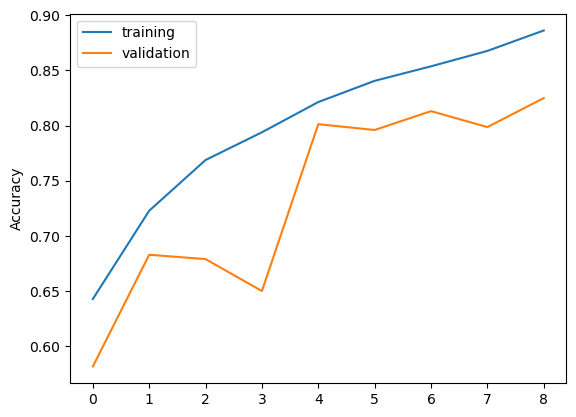

In [100]:
plt.plot(history4.history['accuracy'], label='training')
plt.plot(history4.history['val_accuracy'], label='validation')
plt.ylabel('Accuracy')
plt.legend()

In [101]:
train_corr = model4.fit(X_train, y_train)
test_corr = model4.fit(X_test, y_test)

32/32 [==============================] - 0s 15ms/step - loss: 0.4111 - accuracy: 0.8270


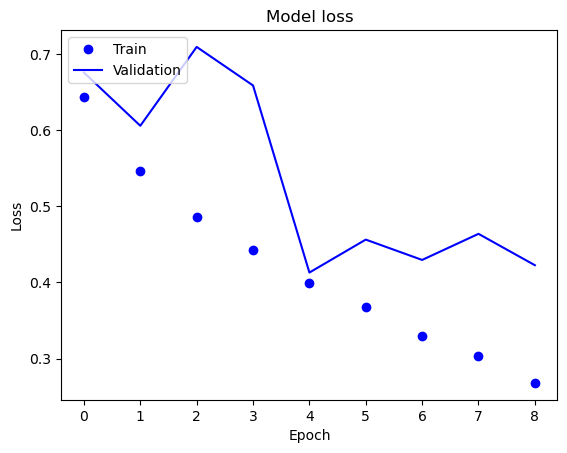

In [102]:
plt.plot(history4.history['loss'], 'bo', label='Training loss')  # 'bo' makes blue dots
plt.plot(history4.history['val_loss'], 'b', label='Validation loss')  # 'b' makes a blue line
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

In [103]:
model4.summary()

Model: "sequential_18"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_54 (Conv2D)          (None, 48, 48, 16)        448       
                                                                 
 batch_normalization_10 (Bat  (None, 48, 48, 16)       64        
 chNormalization)                                                
                                                                 
 max_pooling2d_49 (MaxPoolin  (None, 16, 16, 16)       0         
 g2D)                                                            
                                                                 
 conv2d_55 (Conv2D)          (None, 14, 14, 32)        4640      
                                                                 
 batch_normalization_11 (Bat  (None, 14, 14, 32)       128       
 chNormalization)                                                
                                                     

In [104]:
model5 = Sequential([
    Conv2D(16, (3, 3), activation='relu', input_shape=(50, 50, 3)),
    BatchNormalization(),
    MaxPooling2D(3, 3),
    Conv2D(32, (3, 3), activation='relu'),
    BatchNormalization(),
    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D(2, 2),
    Flatten(),
    Dense(128, activation='relu'),
    Dropout(0.5),
    Dense(1, activation='sigmoid')
])

model5.compile(loss='binary_crossentropy', optimizer=tfa.optimizers.AdamW(weight_decay=1e-4), metrics=['accuracy'])

In [105]:
history5 = model5.fit(X_train, y_train, epochs=30, validation_split=0.04, callbacks=[stop_early])

Epoch 1/30
570/570 [==============================] - 9s 15ms/step - loss: 0.6425 - accuracy: 0.6385 - val_loss: 0.5864 - val_accuracy: 0.6947
Epoch 2/30
570/570 [==============================] - 8s 15ms/step - loss: 0.5527 - accuracy: 0.7168 - val_loss: 0.4913 - val_accuracy: 0.7618
Epoch 3/30
570/570 [==============================] - 8s 15ms/step - loss: 0.5040 - accuracy: 0.7576 - val_loss: 0.4772 - val_accuracy: 0.7579
Epoch 4/30
570/570 [==============================] - 8s 15ms/step - loss: 0.4539 - accuracy: 0.7882 - val_loss: 0.4729 - val_accuracy: 0.7776
Epoch 5/30
570/570 [==============================] - 8s 15ms/step - loss: 0.4208 - accuracy: 0.8105 - val_loss: 0.4232 - val_accuracy: 0.8118
Epoch 6/30
570/570 [==============================] - 8s 15ms/step - loss: 0.3898 - accuracy: 0.8272 - val_loss: 0.4473 - val_accuracy: 0.7789
Epoch 7/30
570/570 [==============================] - 8s 15ms/step - loss: 0.3622 - accuracy: 0.8431 - val_loss: 0.4596 - val_accuracy: 0.7803

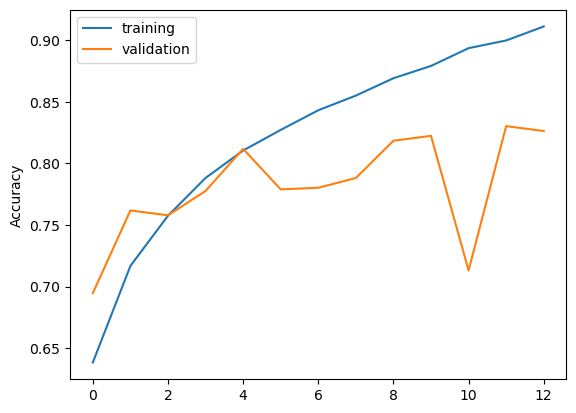

In [106]:
plt.plot(history5.history['accuracy'], label='training')
plt.plot(history5.history['val_accuracy'], label='validation')
plt.ylabel('Accuracy')
plt.legend()

In [107]:
train_corr = model5.fit(X_train, y_train)
test_corr = model5.fit(X_test, y_test)

32/32 [==============================] - 0s 14ms/step - loss: 0.4288 - accuracy: 0.8070


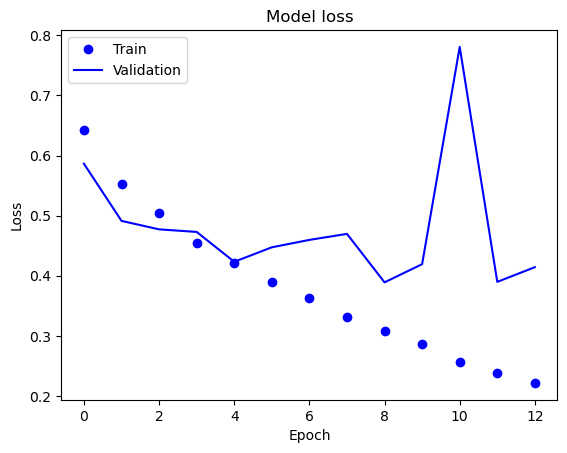

In [108]:
plt.plot(history5.history['loss'], 'bo', label='Training loss')  # 'bo' makes blue dots
plt.plot(history5.history['val_loss'], 'b', label='Validation loss')  # 'b' makes a blue line
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

In [111]:
model6 = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(50, 50, 3)),
    BatchNormalization(),
    MaxPooling2D(2, 2),
    Conv2D(64, (3, 3), activation='relu'),
    BatchNormalization(),
    MaxPooling2D(2, 2),
    Conv2D(128, (3, 3), activation='relu'),
    BatchNormalization(),
    MaxPooling2D(2, 2),
    Flatten(),
    Dense(256, activation='relu'),
    Dropout(0.5),
    Dense(1, activation='sigmoid')
])

model6.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

In [112]:
history6 = model6.fit(X_train, y_train, epochs=30, validation_split=0.04, callbacks=[stop_early])

Epoch 1/30
570/570 [==============================] - 17s 30ms/step - loss: 0.6519 - accuracy: 0.6657 - val_loss: 0.5390 - val_accuracy: 0.7184
Epoch 2/30
570/570 [==============================] - 17s 30ms/step - loss: 0.4933 - accuracy: 0.7626 - val_loss: 0.4560 - val_accuracy: 0.7789
Epoch 3/30
570/570 [==============================] - 17s 29ms/step - loss: 0.4222 - accuracy: 0.8082 - val_loss: 0.4210 - val_accuracy: 0.8171
Epoch 4/30
570/570 [==============================] - 17s 30ms/step - loss: 0.3603 - accuracy: 0.8401 - val_loss: 0.4416 - val_accuracy: 0.7895
Epoch 5/30
570/570 [==============================] - 17s 30ms/step - loss: 0.3131 - accuracy: 0.8619 - val_loss: 0.5164 - val_accuracy: 0.7750
Epoch 6/30
570/570 [==============================] - 17s 30ms/step - loss: 0.2689 - accuracy: 0.8891 - val_loss: 0.5804 - val_accuracy: 0.7474
Epoch 7/30
570/570 [==============================] - 17s 30ms/step - loss: 0.2275 - accuracy: 0.9046 - val_loss: 0.4711 - val_accuracy:

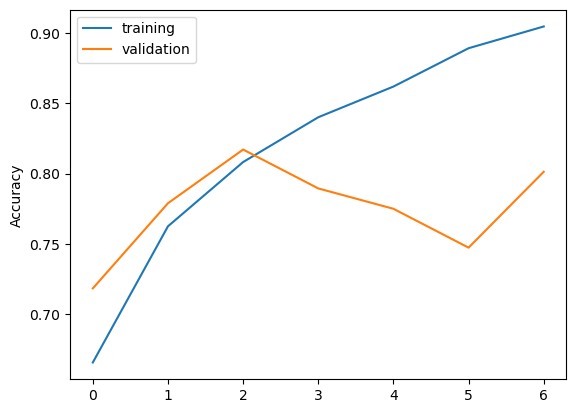

In [113]:
plt.plot(history6.history['accuracy'], label='training')
plt.plot(history6.history['val_accuracy'], label='validation')
plt.ylabel('Accuracy')
plt.legend()

In [114]:
train_corr = model6.fit(X_train, y_train)
test_corr = model6.fit(X_test, y_test)

32/32 [==============================] - 1s 29ms/step - loss: 0.3844 - accuracy: 0.8280


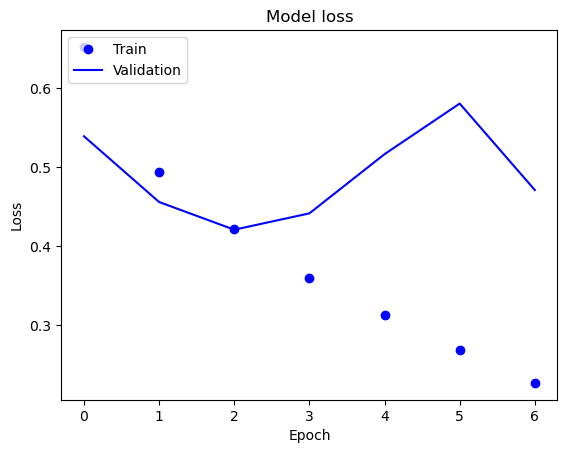

In [115]:
plt.plot(history6.history['loss'], 'bo', label='Training loss')  # 'bo' makes blue dots
plt.plot(history6.history['val_loss'], 'b', label='Validation loss')  # 'b' makes a blue line
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

In [123]:
model7_nadam = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(50, 50, 3)),
    BatchNormalization(),
    MaxPooling2D(2, 2),
    Conv2D(64, (3, 3), activation='relu'),
    BatchNormalization(),
    MaxPooling2D(2, 2),
    Conv2D(128, (3, 3), activation='relu'),
    BatchNormalization(),
    MaxPooling2D(2, 2),
    Flatten(),
    Dense(256, activation='relu'),
    Dropout(0.5),
    Dense(1, activation='sigmoid')
])

model7_nadam.compile(loss='binary_crossentropy', optimizer='nadam', metrics=['accuracy'])

In [124]:
stop_early = EarlyStopping(patience=2)

In [125]:
history7_nadam = model7_nadam.fit(X_train, y_train, epochs=30, validation_split=0.04, callbacks=[stop_early])

Epoch 1/30
570/570 [==============================] - 18s 31ms/step - loss: 0.6456 - accuracy: 0.6695 - val_loss: 0.5312 - val_accuracy: 0.7329
Epoch 2/30
570/570 [==============================] - 17s 30ms/step - loss: 0.4856 - accuracy: 0.7673 - val_loss: 0.4535 - val_accuracy: 0.7750
Epoch 3/30
570/570 [==============================] - 17s 30ms/step - loss: 0.4129 - accuracy: 0.8141 - val_loss: 0.3995 - val_accuracy: 0.8092
Epoch 4/30
570/570 [==============================] - 17s 29ms/step - loss: 0.3630 - accuracy: 0.8377 - val_loss: 0.4223 - val_accuracy: 0.8224
Epoch 5/30
570/570 [==============================] - 17s 30ms/step - loss: 0.3138 - accuracy: 0.8605 - val_loss: 0.3960 - val_accuracy: 0.8039
Epoch 6/30
570/570 [==============================] - 17s 29ms/step - loss: 0.2670 - accuracy: 0.8877 - val_loss: 0.4476 - val_accuracy: 0.8184
Epoch 7/30
570/570 [==============================] - 17s 29ms/step - loss: 0.2265 - accuracy: 0.9047 - val_loss: 0.4215 - val_accuracy:

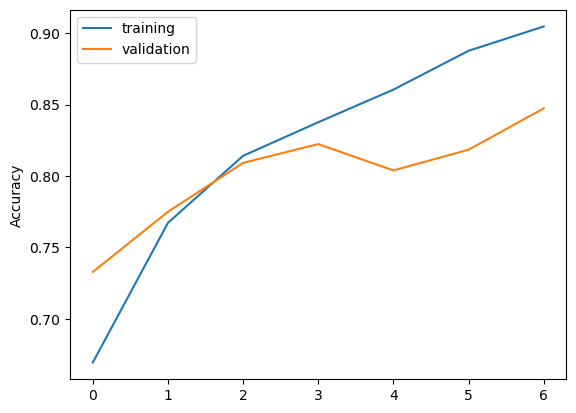

In [128]:
plt.plot(history7_nadam.history['accuracy'], label='training')
plt.plot(history7_nadam.history['val_accuracy'], label='validation')
plt.ylabel('Accuracy')
plt.legend()

In [129]:
train_corr = model7_nadam.fit(X_train, y_train)
test_corr = model7_nadam.fit(X_test, y_test)

32/32 [==============================] - 1s 28ms/step - loss: 0.4305 - accuracy: 0.8240


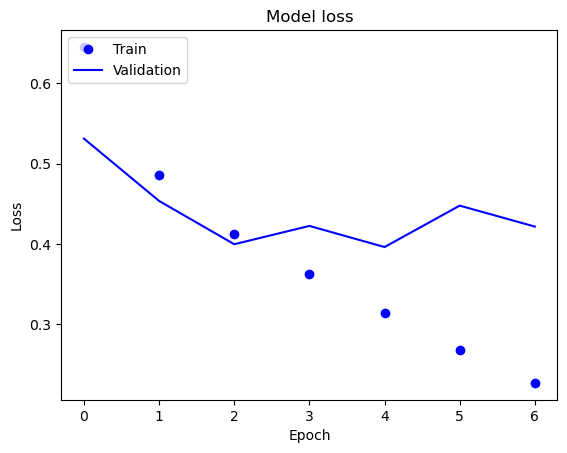

In [130]:
plt.plot(history7_nadam.history['loss'], 'bo', label='Training loss')  # 'bo' makes blue dots
plt.plot(history7_nadam.history['val_loss'], 'b', label='Validation loss')  # 'b' makes a blue line
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

In [41]:
from keras.preprocessing.image import ImageDataGenerator

In [18]:
early_stopping = EarlyStopping(monitor='val_loss', patience=5)

In [21]:
model8 = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(50, 50, 3)),
    BatchNormalization(),
    MaxPooling2D(2, 2),
    Dropout(0.3),  
    Conv2D(64, (3, 3), activation='relu'),
    BatchNormalization(),
    MaxPooling2D(2, 2),
    Dropout(0.4),  
    Conv2D(128, (3, 3), activation='relu'),
    BatchNormalization(),
    MaxPooling2D(2, 2),
    Flatten(),
    Dense(256, activation='relu'),
    Dropout(0.6),  
    Dense(1, activation='sigmoid')
])

model8.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

In [22]:
history8 = model8.fit(X_train, y_train, epochs=30, validation_split=0.04, callbacks=[stop_early])

Epoch 1/30


2024-01-31 14:34:55.929029: W tensorflow/tsl/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz


570/570 [==============================] - 19s 32ms/step - loss: 0.7300 - accuracy: 0.6116 - val_loss: 0.6835 - val_accuracy: 0.6474
Epoch 2/30
570/570 [==============================] - 19s 33ms/step - loss: 0.5800 - accuracy: 0.6966 - val_loss: 0.6409 - val_accuracy: 0.6855
Epoch 3/30
570/570 [==============================] - 20s 35ms/step - loss: 0.5280 - accuracy: 0.7379 - val_loss: 0.5178 - val_accuracy: 0.7487
Epoch 4/30
570/570 [==============================] - 19s 34ms/step - loss: 0.4968 - accuracy: 0.7632 - val_loss: 0.9316 - val_accuracy: 0.6145
Epoch 5/30
570/570 [==============================] - 20s 36ms/step - loss: 0.4638 - accuracy: 0.7816 - val_loss: 0.4774 - val_accuracy: 0.7737
Epoch 6/30
570/570 [==============================] - 21s 36ms/step - loss: 0.4323 - accuracy: 0.8060 - val_loss: 0.4973 - val_accuracy: 0.7908
Epoch 7/30
570/570 [==============================] - 21s 37ms/step - loss: 0.4107 - accuracy: 0.8142 - val_loss: 0.4586 - val_accuracy: 0.7895
Epo

In [23]:
train_corr = model8.fit(X_train, y_train)
test_corr = model8.fit(X_test, y_test)

32/32 [==============================] - 1s 38ms/step - loss: 0.3862 - accuracy: 0.8220


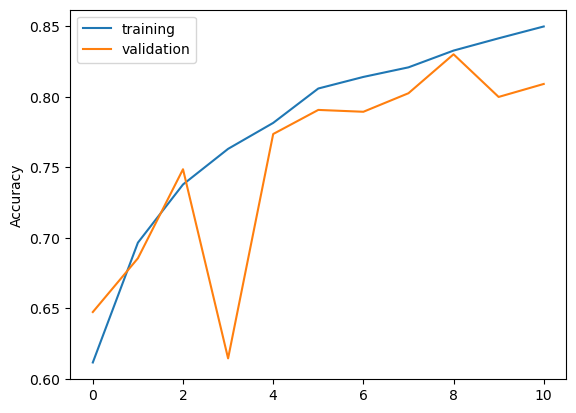

In [25]:
plt.plot(history8.history['accuracy'], label='training')
plt.plot(history8.history['val_accuracy'], label='validation')
plt.ylabel('Accuracy')
plt.legend()

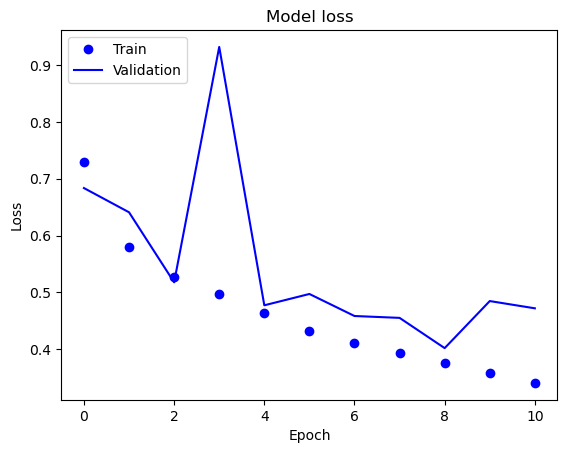

In [26]:
plt.plot(history8.history['loss'], 'bo', label='Training loss')  # 'bo' makes blue dots
plt.plot(history8.history['val_loss'], 'b', label='Validation loss')  # 'b' makes a blue line
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

In [42]:
datagen = ImageDataGenerator(
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest')

In [28]:
model9 = Sequential([
    Conv2D(16, (3, 3), activation='relu', input_shape=(50, 50, 3)),
    BatchNormalization(),
    MaxPooling2D(2, 2),
    Dropout(0.3),  
    Conv2D(32, (3, 3), activation='relu'),
    BatchNormalization(),
    MaxPooling2D(2, 2),
    Dropout(0.4),  
    Conv2D(64, (3, 3), activation='relu'),
    BatchNormalization(),
    MaxPooling2D(2, 2),
    Flatten(),
    Dense(128, activation='relu'),
    Dropout(0.6),  
    Dense(1, activation='sigmoid')
])

model9.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

In [32]:
history9 = model9.fit(
    datagen.flow(X_train, y_train, batch_size=32),
    steps_per_epoch=len(X_train) / 32,
    epochs=30,  
    validation_data=(X_test, y_test),
    callbacks=[early_stopping])

Epoch 1/30
593/593 [==============================] - 16s 25ms/step - loss: 0.7056 - accuracy: 0.5815 - val_loss: 0.8406 - val_accuracy: 0.5640
Epoch 2/30
593/593 [==============================] - 15s 26ms/step - loss: 0.6535 - accuracy: 0.6225 - val_loss: 0.8971 - val_accuracy: 0.5600
Epoch 3/30
593/593 [==============================] - 16s 27ms/step - loss: 0.6387 - accuracy: 0.6336 - val_loss: 0.6751 - val_accuracy: 0.6330
Epoch 4/30
593/593 [==============================] - 16s 27ms/step - loss: 0.6229 - accuracy: 0.6498 - val_loss: 0.5870 - val_accuracy: 0.6930
Epoch 5/30
593/593 [==============================] - 16s 27ms/step - loss: 0.6095 - accuracy: 0.6649 - val_loss: 0.7084 - val_accuracy: 0.6170
Epoch 6/30
593/593 [==============================] - 16s 27ms/step - loss: 0.5977 - accuracy: 0.6808 - val_loss: 0.5549 - val_accuracy: 0.7340
Epoch 7/30
593/593 [==============================] - 16s 27ms/step - loss: 0.5888 - accuracy: 0.6898 - val_loss: 0.5380 - val_accuracy:

In [33]:
train_corr = model9.fit(X_train, y_train)
test_corr = model9.fit(X_test, y_test)

32/32 [==============================] - 1s 24ms/step - loss: 0.4474 - accuracy: 0.7840


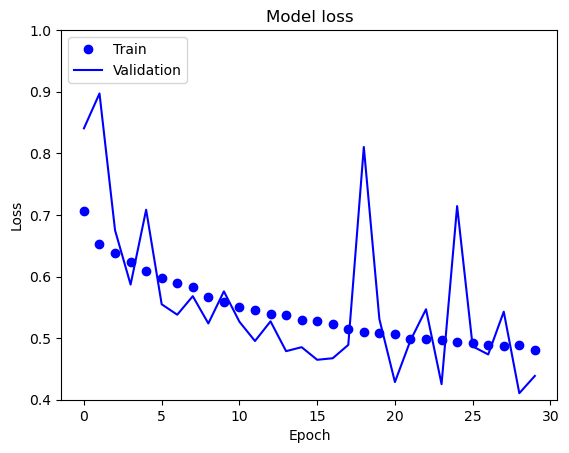

In [37]:
plt.plot(history9.history['loss'], 'bo', label='Training loss')  # 'bo' makes blue dots
plt.plot(history9.history['val_loss'], 'b', label='Validation loss')  # 'b' makes a blue line
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.ylim(0.4, 1)  
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

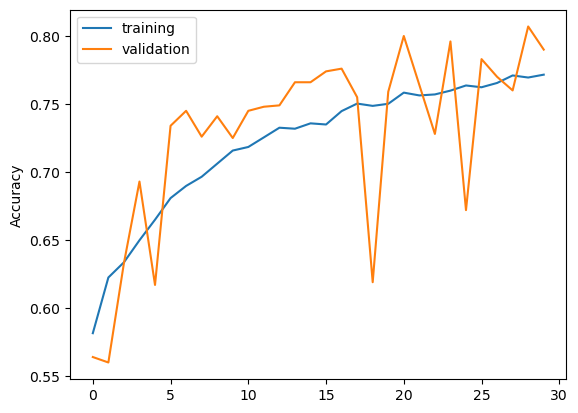

In [39]:
plt.plot(history9.history['accuracy'], label='training')
plt.plot(history9.history['val_accuracy'], label='validation')
plt.ylabel('Accuracy')
plt.legend()

In [43]:
model10 = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(50, 50, 3)),
    BatchNormalization(),
    MaxPooling2D(2, 2),
    Dropout(0.3),  
    Conv2D(64, (3, 3), activation='relu'),
    BatchNormalization(),
    MaxPooling2D(2, 2),
    Dropout(0.4),  
    Conv2D(128, (3, 3), activation='relu'),
    BatchNormalization(),
    MaxPooling2D(2, 2),
    Flatten(),
    Dense(256, activation='relu'),
    Dropout(0.6),  
    Dense(1, activation='sigmoid')
])

model10.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

In [ ]:
stop_early = EarlyStopping(patience=6)

In [45]:
history10 = model10.fit(
    datagen.flow(X_train, y_train, batch_size=32),
    steps_per_epoch=len(X_train) / 32,
    epochs=50,  
    validation_data=(X_test, y_test),
    callbacks=[stop_early])

Epoch 1/50
593/593 [==============================] - 21s 34ms/step - loss: 0.7281 - accuracy: 0.5868 - val_loss: 0.7846 - val_accuracy: 0.6300
Epoch 2/50
593/593 [==============================] - 21s 36ms/step - loss: 0.6445 - accuracy: 0.6254 - val_loss: 0.6786 - val_accuracy: 0.6350
Epoch 3/50
593/593 [==============================] - 23s 39ms/step - loss: 0.6227 - accuracy: 0.6585 - val_loss: 0.5648 - val_accuracy: 0.7190
Epoch 4/50
593/593 [==============================] - 24s 41ms/step - loss: 0.6083 - accuracy: 0.6718 - val_loss: 0.6076 - val_accuracy: 0.6710
Epoch 5/50
593/593 [==============================] - 24s 40ms/step - loss: 0.5925 - accuracy: 0.6881 - val_loss: 0.5452 - val_accuracy: 0.7380
Epoch 6/50
593/593 [==============================] - 24s 41ms/step - loss: 0.5806 - accuracy: 0.6982 - val_loss: 0.8355 - val_accuracy: 0.6320
Epoch 7/50
593/593 [==============================] - 24s 41ms/step - loss: 0.5615 - accuracy: 0.7101 - val_loss: 0.5374 - val_accuracy:

In [47]:
train_corr = model10.fit(X_train, y_train)
test_corr = model10.fit(X_test, y_test)

32/32 [==============================] - 1s 40ms/step - loss: 0.4314 - accuracy: 0.8100


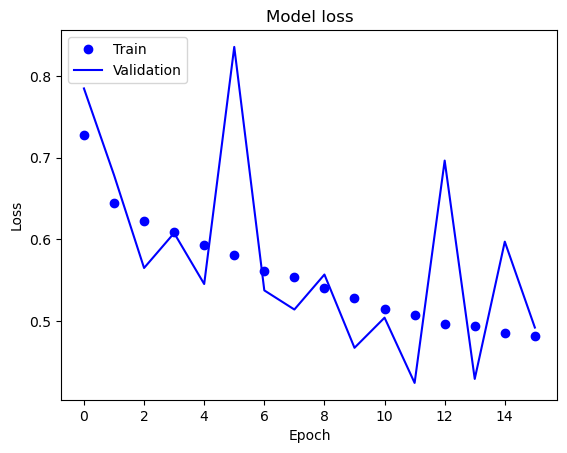

In [48]:
plt.plot(history10.history['loss'], 'bo', label='Training loss')  # 'bo' makes blue dots
plt.plot(history10.history['val_loss'], 'b', label='Validation loss')  # 'b' makes a blue line
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
#plt.ylim(0.4, 1)  
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

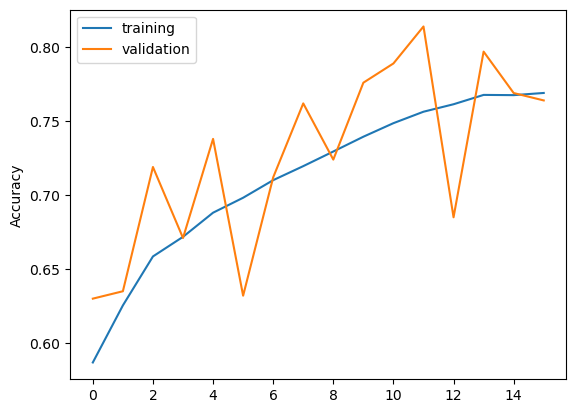

In [49]:
plt.plot(history10.history['accuracy'], label='training')
plt.plot(history10.history['val_accuracy'], label='validation')
plt.ylabel('Accuracy')
plt.legend()

In [50]:
predictions = model10.predict(test_sample)

1/1 [==============================] - 0s 63ms/step


/var/folders/wd/5wdb0pjj4cd8s_w239h9zjk40000gn/T/ipykernel_36017/738337879.py:11: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  plt.title(text.format(net_claims * 100., it_is_really, ['is wrong', 'is right'][is_net_correct]))


(-0.5, 49.5, 49.5, -0.5)

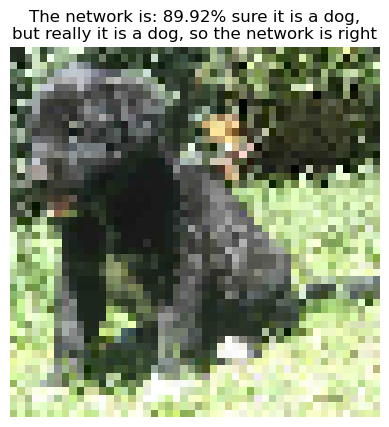

In [52]:
check_idx = 19
plt.imshow(test_sample[check_idx] / 255)


text = 'The network is: {:.2f}% sure it is a dog,\nbut really it is a {}, so the network {}'
correct_response = true_labels[check_idx]
it_is_really = ['cat', 'dog'][correct_response]
net_claims = predictions[check_idx, 0]
is_net_correct = np.abs(net_claims - correct_response) < 0.5

plt.title(text.format(net_claims * 100., it_is_really, ['is wrong', 'is right'][is_net_correct]))
plt.axis('off')

In [60]:
img = load_img('/Users/miloszksiazek/Desktop/ALK/python_ML/FINAL/IMG_4017-kopia.jpeg', target_size=(50,50))

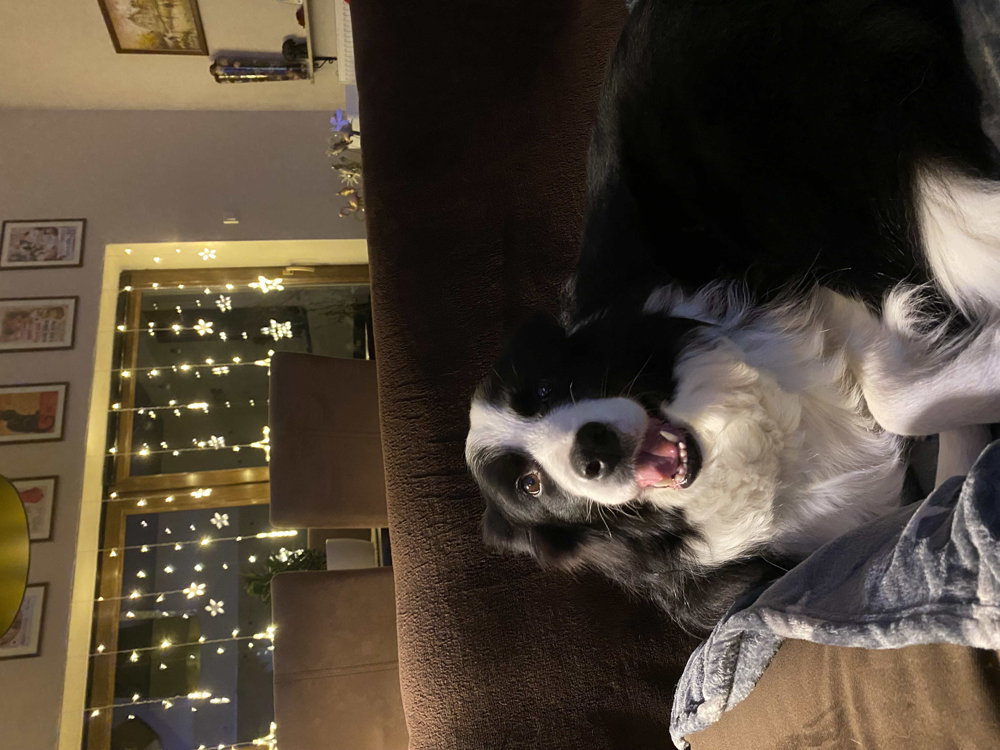

In [64]:
load_img('/Users/miloszksiazek/Desktop/ALK/python_ML/FINAL/IMG_4017-kopia.jpeg')

In [62]:
img_array = img_to_array(img)

In [63]:
model10.predict(img_array.reshape(1,50,50,3))

1/1 [==============================] - 0s 12ms/step


array([[0.7256535]], dtype=float32)

In [65]:
img = load_img('/Users/miloszksiazek/Desktop/ALK/python_ML/FINAL/IMG_3977.PNG', target_size=(50,50))

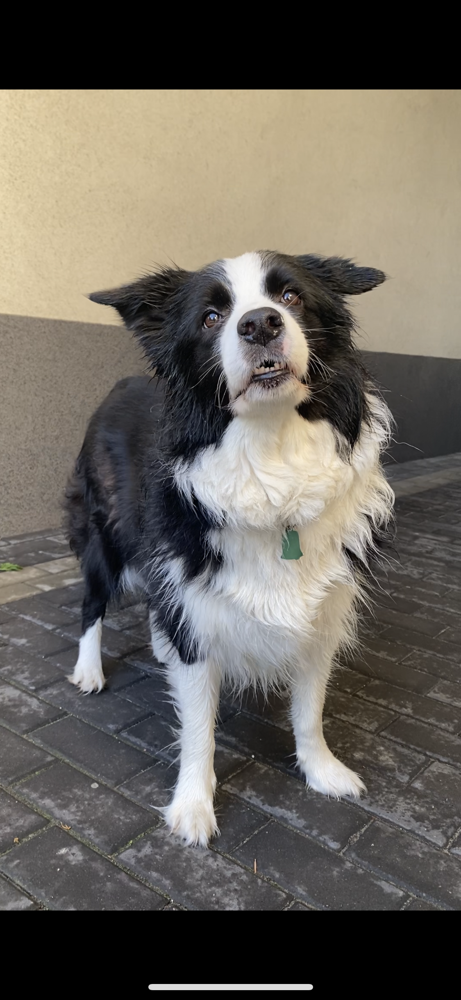

In [66]:
load_img('/Users/miloszksiazek/Desktop/ALK/python_ML/FINAL/IMG_3977.PNG')

In [67]:
img_array = img_to_array(img)

In [68]:
model10.predict(img_array.reshape(1,50,50,3))

1/1 [==============================] - 0s 15ms/step


array([[0.6510912]], dtype=float32)

In [53]:
import matplotlib.image as mpimg


In [54]:
predictions = model10.predict(X_test)

32/32 [==============================] - 0s 13ms/step


In [55]:
predicted_classes = (predictions > 0.5).astype(int)

In [80]:
#correct = []
#incorrect = []
#for y in y_test:
#    for p in predicted_classes:
#        if p==y:
#            correct.append(p)
#for y in y_test:
#    for p in predicted_classes:
#        if p!=y:
#            incorrect.append(p)

In [93]:
correct = np.where(predicted_classes == y_test)[0]
incorrect = np.where(predicted_classes != y_test)[0]

In [81]:
#correct_sample = correct[:6]
#incorrect_sample = incorrect[:6]

In [107]:
correct_sample = np.random.choice(correct, 6, replace=False)
incorrect_sample = np.random.choice(incorrect, 6, replace=False)

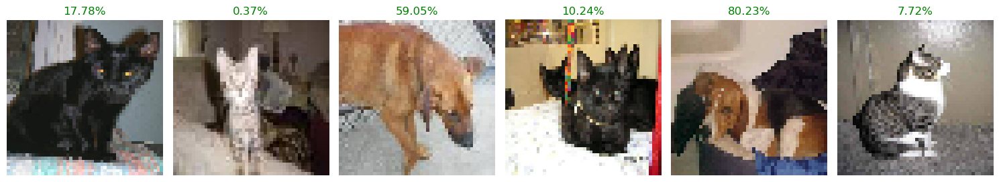

In [118]:
plt.figure(figsize=(15, 5))
for i, index in enumerate(correct_sample):
    plt.subplot(1, 6, i + 1)
    plt.imshow(X_test[index]/255)  
    plt.title(f"{predictions[index][0]*100:.2f}%", color='green')
    plt.axis('off')
plt.tight_layout()
plt.show()

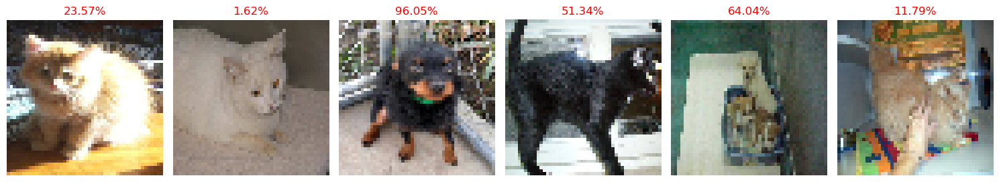

In [123]:
plt.figure(figsize=(15, 5))
for i, index in enumerate(incorrect_sample):
    plt.subplot(1, 6, i + 1)
    plt.imshow(X_test[index]/255)  
    # Display the prediction accuracy as the title in red
    plt.title(f"{predictions[index][0]*100:.2f}%", color='red')
    plt.axis('off')
plt.tight_layout()
plt.show()

#idk why the plot is showing imo correctly predicted samples but the code within incorrect_samples is well written and its showing incorrect predicted samples

In [103]:
y_test[:6]

array([1, 1, 1, 0, 0, 0])

In [104]:
predicted_classes[:6]

array([[1],
       [1],
       [1],
       [0],
       [0],
       [1]])

In [92]:
correct_sample

array([338, 455, 534, 646, 349, 333])

In [124]:
train_corr = model10.fit(X_train, y_train)
test_corr = model10.fit(X_test, y_test)

32/32 [==============================] - 1s 30ms/step - loss: 0.3868 - accuracy: 0.8310


In [125]:
#i have used optimizer adam. I ve tried to use different like nadam or adamw but the model did not perform as well as my final model10 with adam


In [126]:
import keras

In [127]:
keras.models.save_model(model=model10, filepath=r'/Users/miloszksiazek/Desktop/ALK/python_ML/FINAL/MILOSZ_KSIAZEK_48745_MODEL', 
                           save_format='h5')